# PCA from Scratch

DS 5001 Text as Data

**Purpose:**  To implement PCA from scratch and explore application to Austen-Melville corpus.

# Set Up

## Import

In [224]:
import pandas as pd
import numpy as np
from scipy.linalg import norm

In [225]:
import plotly_express as px
import seaborn as sns

In [226]:
sns.set(style='ticks')

## Config

In [227]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']
local_lib = config['DEFAULT']['local_lib']

In [228]:
data_prefix = 'austen-melville'

In [229]:
OHCO = ['book_id', 'chap_id']

In [230]:
# Added after class
norm_docs = False # This has the effect of exaggerating variance when False
center_term_vectors = False # This has the effect of demoting authorship when False

We pick a color map for our gradient visualizations. For more info on color maps, see the [Matplotlib docs](https://matplotlib.org/stable/tutorials/colors/colormaps.html) on the subject.

In [231]:
colors = "YlGnBu" 
# colors = "Spectral"

# Prepare the Data

## Import tables

**Downloads**

- [austen-melville-VOCAB2.csv](https://www.dropbox.com/scl/fi/u4t0o5zpoaunyi4l5dklr/austen-melville-VOCAB2.csv?rlkey=5m3fiuucraflg4ntoxqc0t3hv&dl=0)
- [austen-melville-LIB_LABELS.csv](https://www.dropbox.com/scl/fi/f63v0pjqemsody71c9sun/austen-melville-LIB_LABELS.csv?rlkey=0ue1mz9x2ycqybcwti0vsnm9y&dl=0)
- [austen-melville-BOW-CHAPS.csv](https://www.dropbox.com/scl/fi/jykn79w6zfr26bushqoda/austen-melville-BOW-CHAPS.csv?rlkey=c36zwn53lcnsa98crqwb8lozc&dl=0)

In [232]:
LIB = pd.read_csv(f'{output_dir}/{data_prefix}-LIB_LABELS.csv').set_index('book_id').dropna()
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB.csv').set_index('term_str')
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-CHAPS.csv').set_index(OHCO+['term_str'])

In [233]:
VOCAB[['n','p','i']].head(20)

,n,p,i
term_str,,,
0,2,9.713651e-07,19.973483
1,23,1.117070e-05,16.449921
10,6,2.914095e-06,18.388520
100,2,9.713651e-07,19.973483
1000,2,9.713651e-07,19.973483
10000,3,1.457048e-06,19.388520
10000000,1,4.856826e-07,20.973483
10440,1,4.856826e-07,20.973483
10800,2,9.713651e-07,19.973483


## Generate reduced `TFIDF` table

We reduce the feature space of the the TFIDF table by selecting the top 1000 significant nouns, verbs, and adjectives.

Note that the `TFIDF` table is an extension of an implied `DOC` table, where each doc is a chapter in this case.

In [234]:
# VOCAB.max_pos_group.value_counts()

In [235]:
TFIDF = BOW['tfidf'].unstack(fill_value=0)

In [236]:
VOCAB['df'] = TFIDF.astype(bool).sum()

In [237]:
VOCAB['dfidf'] = VOCAB.df * np.log2(len(TFIDF)/VOCAB.df)

In [238]:
pos_set = ['NN', 'VB']

In [239]:
VSHORT = VOCAB[VOCAB.max_pos_group.isin(['NN', 'VB', 'JJ']) & ~VOCAB.max_pos.isin(['NNP'])].sort_values('dfidf', ascending=False).head(5000)

In [240]:
TFIDF = TFIDF[VSHORT.index]

In [241]:
TFIDF

term_str             home     cried   certain   looking    manner   general  \
book_id chap_id                                                               
105     1        0.001097  0.000000  0.000553  0.000000  0.000000  0.000000   
        2        0.002187  0.000000  0.000000  0.000743  0.000746  0.000000   
        3        0.001522  0.001012  0.000512  0.001033  0.000000  0.000000   
        4        0.001595  0.000000  0.000805  0.000000  0.000816  0.001632   
        5        0.000866  0.000000  0.000000  0.000883  0.001773  0.000000   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.000000  0.002182  0.000000  0.000000  0.000000  0.000000   
        111      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        112      0.002184  0.000000  0.000000  0.000000  0.000000  0.000000   
        113      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        114      0.000000  0.004452  0.000000  0.000000  0.000000  0.000000   

term_str             felt       set        oh     times  ...  breed  hug  \
book_id chap_id                                          ...               
105     1        0.002244  0.000538  0.000000  0.000000  ...    0.0  0.0   
        2        0.002238  0.000000  0.000000  0.000000  ...    0.0  0.0   
        3        0.000000  0.001494  0.000992  0.000496  ...    0.0  0.0   
        4        0.000816  0.000000  0.000000  0.000000  ...    0.0  0.0   
        5        0.001330  0.001701  0.002540  0.001270  ...    0.0  0.0   
...                   ...       ...       ...       ...  ...    ...  ...   
34970   110      0.002238  0.000000  0.000000  0.000000  ...    0.0  0.0   
        111      0.000000  0.000000  0.003893  0.000000  ...    0.0  0.0   
        112      0.000000  0.000000  0.000000  0.000000  ...    0.0  0.0   
        113      0.000000  0.000000  0.011104  0.000000  ...    0.0  0.0   
        114      0.000000  0.000000  0.008723  0.000000  ...    0.0  0.0   

term_str         lash  heathen  recesses  syllables  consumed  kindest  \
book_id chap_id                                                          
105     1         0.0      0.0       0.0        0.0       0.0      0.0   
        2         0.0      0.0       0.0        0.0       0.0      0.0   
        3         0.0      0.0       0.0        0.0       0.0      0.0   
        4         0.0      0.0       0.0        0.0       0.0      0.0   
        5         0.0      0.0       0.0        0.0       0.0      0.0   
...               ...      ...       ...        ...       ...      ...   
34970   110       0.0      0.0       0.0        0.0       0.0      0.0   
        111       0.0      0.0       0.0        0.0       0.0      0.0   
        112       0.0      0.0       0.0        0.0       0.0      0.0   
        113       0.0      0.0       0.0        0.0       0.0      0.0   
        114       0.0      0.0       0.0        0.0       0.0      0.0   

term_str         delayed  curses  
book_id chap_id                   
105     1            0.0     0.0  
        2            0.0     0.0  
        3            0.0     0.0  
        4            0.0     0.0  
        5            0.0     0.0  
...                  ...     ...  
34970   110          0.0     0.0  
        111          0.0     0.0  
        112          0.0     0.0  
        113          0.0     0.0  
        114          0.0     0.0  

[1185 rows x 5000 columns]

## Add some labels to `LIB`

In [242]:
genre_csv = """
105, domestic, romance
121, gothic, satire
141, domestic, satire
158, domestic, romance
161, domestic, romance
946, domestic, romance
1212, domestic, satire
1342, domestic, romance
1900, travel, adventure
2701, sea, adventure
4045, travel, adventure
8118, sea, adventure
10712, sea, critical
13720, sea, adventure
13721, sea, adventure
15422, historical, adventure
15859, mixed, mixed
21816, travel, satire
34970, gothic, psychological
53861, mixed, mixed
""".split('\n')[1:-1]
genre = pd.DataFrame([line.split(', ') for line in genre_csv], columns=['book_id','genre', 'mode'])
genre.book_id = genre.book_id.astype('int')
genre = genre.set_index('book_id')

In [243]:
LIB = pd.concat([LIB, genre], axis=1)

In [244]:
LIB_COLS = ['author','title', 'label', 'genre', 'mode']

In [245]:
LIB[LIB_COLS].head()

,author,title,label,genre,mode
book_id,,,,,
105,"AUSTEN, JANE",PERSUASION,Austen: Persuasion (105),domestic,romance
121,"AUSTEN, JANE",NORTHANGER ABBEY,Austen: Northanger Abbey (121),gothic,satire
141,"AUSTEN, JANE",MANSFIELD PARK,Austen: Mansfield Park (141),domestic,satire
158,"AUSTEN, JANE",EMMA,Austen: Emma (158),domestic,romance
161,"AUSTEN, JANE",SENSE AND SENSIBILITY,Austen: Sense And Sensibilit (161),domestic,romance


# PCA Process

## Normalize doc vector lengths

We use L2 normalization, which scales documents by their pythagorean (Euclidean) length.

In [246]:
# TFIDF_L2 = (TFIDF.T / np.sqrt(np.square(TFIDF).sum(axis=1))).T
TFIDF_L2 = (TFIDF.T / norm(TFIDF, 2, axis=1)).T

In [247]:
# TFIDF_L2

## Handle NULLs

Remove bags with null. These result from the bags not having terms in the reduced vocabulary.

In [248]:
a = len(TFIDF_L2)
TFIDF_L2 = TFIDF_L2.dropna()
b = len(TFIDF_L2)
bag_loss = a - b
bag_loss

2

## Normalize term vector variance

We do **not** normalize variance, which we would do with data containing divergent units of measure. \
This is because to do so would exaggerate the importance of rare words (see Ng, 2008: 6m40s–8m00s).

## Center the term vectors

We can take the column-wise means (the means for the _term_ vectors), but note that this alters the cosine angles between terms.

We don't don't have to compute this here if we use Pandas method `df.cov(),` which does it for us.

In [249]:
# TFIDF_L2 = TFIDF_L2 - TFIDF_L2.mean()

## Compute Covariance Matrix

$n = |X| = |Y|$

$Cov(X,Y) = \dfrac{\sum_{i=1}^{n} (x_i - \mu_X) (y_i - \mu_Y)}{n - 1} = \dfrac{XY}{n-1}$

We could we use the built in Pandas method here, but compute it ourselves.

In [250]:
COV = TFIDF_L2.cov() # This also centers the vectorsf
# COV = TFIDF_L2.T.dot(TFIDF_L2) / (TFIDF_L2.shape[0] - 1) # By Hand

In [251]:
COV.head()

term_str,home,cried,certain,looking,manner,general,felt,set,oh,times,...,breed,hug,lash,heathen,recesses,syllables,consumed,kindest,delayed,curses
term_str,,,,,,,,,,,,,,,,,,,,,
home,0.000334,0.000018,-0.000014,0.000045,0.000045,0.000052,0.000099,0.000022,0.000043,-4.361102e-07,...,-0.000004,-0.000004,-6.860105e-06,7.305070e-06,-2.885087e-06,-0.000006,-4.607897e-06,0.000011,0.000007,1.605098e-06
cried,0.000018,0.000672,-0.000011,0.000030,0.000008,-0.000025,0.000007,0.000007,0.000143,-2.221014e-05,...,0.000017,0.000002,1.068160e-06,-3.066480e-06,-3.399287e-06,0.000004,-1.103412e-05,0.000009,0.000008,6.390152e-06
certain,-0.000014,-0.000011,0.000201,-0.000011,0.000017,0.000016,0.000007,0.000009,-0.000021,1.768720e-05,...,0.000005,0.000001,1.728019e-07,1.856239e-06,2.146738e-06,0.000004,3.454246e-07,-0.000002,0.000006,4.062565e-07
looking,0.000045,0.000030,-0.000011,0.000249,0.000016,0.000008,0.000037,0.000021,0.000026,1.641412e-05,...,-0.000003,0.000001,-5.625625e-06,-3.984368e-07,2.044434e-06,0.000007,1.794545e-06,0.000004,0.000004,-1.022024e-06
manner,0.000045,0.000008,0.000017,0.000016,0.000187,0.000029,0.000078,0.000009,0.000031,-1.641637e-06,...,-0.000003,-0.000001,-1.028854e-06,1.162462e-07,6.455686e-07,-0.000001,7.818897e-07,0.000011,0.000007,-6.924240e-06


## Decompose the Matrix

There a at least three options to choose from. We go with SciPy's Hermitian Eigendecomposition \
method `eigh()`, since our covarience matrix is symmetric.

In [252]:
from scipy.linalg import eigh

In [253]:
eig_vals, eig_vecs = eigh(COV)

## Convert eigen data to dataframes

In [254]:
EIG_VEC = pd.DataFrame(eig_vecs, index=COV.index, columns=COV.index)
EIG_VAL = pd.DataFrame(eig_vals, index=COV.index, columns=['eig_val'])
EIG_VAL.index.name = 'term_str'

In [255]:
EIG_VEC.iloc[:10, :10].style.background_gradient(cmap=colors)

term_str,home,cried,certain,looking,manner,general,felt,set,oh,times
term_str,,,,,,,,,,
home,-0.008173,-0.025281,0.024647,0.022216,-0.058963,-0.025532,-0.027180,0.088096,-0.159038,0.159331
cried,0.005993,-0.000454,0.019970,-0.025193,-0.023714,-0.005545,-0.138117,-0.083805,0.017314,-0.095454
certain,0.001921,-0.060516,0.027923,0.019043,-0.072890,0.002265,-0.051732,0.038014,-0.229830,0.161179
looking,0.015552,-0.022475,0.005635,0.015480,-0.029012,0.008241,-0.009510,0.027906,-0.131376,0.089426
manner,0.026795,0.025978,0.023415,0.001682,-0.054708,-0.043569,0.027763,-0.005334,0.083396,0.050066
general,-0.005895,-0.034012,-0.035940,0.019134,0.051551,0.040784,-0.006298,0.018923,-0.045576,-0.058498
felt,-0.018827,-0.035907,0.014455,-0.023263,-0.014410,0.005958,-0.104273,-0.015858,-0.009633,-0.069550
set,-0.001803,0.001960,0.005414,-0.007291,0.009183,-0.003989,0.045540,0.026374,0.016348,0.003627
oh,0.007785,0.003525,-0.022030,-0.001257,0.010916,0.018978,0.047564,0.052614,0.114003,0.038184


## Select Principal Components

Next, we associate each eigenvalue with its corresponding *column* in the eigenvalue matrix. \
This is why we transpose the `EIG_VEC` dataframe.

## Combine eigenvalues and eignvectors

In [256]:
EIG_PAIRS = EIG_VAL.join(EIG_VEC.T)

In [257]:
EIG_PAIRS.sort_values('eig_val', ascending=False).head(10)

,eig_val,home,cried,certain,looking,manner,general,felt,set,oh,...,breed,hug,lash,heathen,recesses,syllables,consumed,kindest,delayed,curses
term_str,,,,,,,,,,,,,,,,,,,,,
curses,0.029835,-0.044456,-0.005779,-0.003176,-0.014338,-0.035223,-0.031659,-0.058332,-0.008730,-0.031270,...,0.002641,0.002252,0.005791,0.002247,0.002751,-0.000533,0.001108,-0.006958,-0.008662,0.004398
delayed,0.012971,-0.020406,0.023909,-0.009149,-0.024198,-0.012478,-0.013059,-0.003414,-0.021664,0.067755,...,-0.003004,-0.000538,-0.005778,-0.001521,-0.004318,0.005832,-0.002335,-0.000530,0.000312,0.001134
kindest,0.010417,0.012649,0.028712,-0.002111,0.001255,0.004902,0.010842,0.020085,0.007611,0.056582,...,-0.000452,-0.000472,-0.002016,-0.003884,-0.007718,-0.000844,0.001017,0.001723,0.002763,0.001064
consumed,0.009258,-0.027308,-0.043735,0.003548,-0.043091,-0.006738,0.001911,-0.028542,-0.018462,-0.053237,...,-0.001537,-0.001786,-0.008151,-0.001627,-0.001925,-0.002234,0.001237,-0.001453,-0.002257,-0.002148
syllables,0.007976,0.017941,0.010264,0.002630,0.030248,0.010726,0.013564,0.028077,0.012262,0.017274,...,0.002327,0.003594,-0.018692,0.006550,0.011341,0.005522,0.008764,0.000599,0.002704,0.003664
recesses,0.006210,0.000752,-0.120037,-0.005793,-0.045510,0.003571,0.022224,0.015972,-0.007113,-0.085351,...,-0.003349,-0.003868,0.012862,-0.000230,0.003227,-0.003347,0.001887,-0.002259,0.002335,0.002759
heathen,0.005744,-0.016345,-0.075209,-0.004388,0.038421,-0.006440,-0.012984,-0.000300,-0.003635,-0.002344,...,-0.010248,-0.005176,-0.026450,0.001408,-0.000468,-0.003486,-0.003314,-0.001296,-0.001281,-0.008338
lash,0.005285,0.011524,0.053854,-0.041853,-0.022612,-0.012930,-0.051391,0.012417,-0.003956,0.012873,...,-0.001856,0.001520,-0.020855,-0.009681,-0.002809,-0.006819,-0.008589,-0.000558,0.005531,0.002900
hug,0.004546,-0.006473,0.016203,0.025064,-0.031046,0.011881,0.003906,0.032316,0.003904,-0.023072,...,0.009209,0.006472,0.006951,-0.000636,0.001898,0.002703,0.003828,-0.001963,0.002111,0.009944


Next, we sort in descending order and pick the top K (=10).

## Compute and Show Explained Variance

We might use this value to sort our components.

In [258]:
EIG_PAIRS['exp_var'] = np.round((EIG_PAIRS.eig_val / EIG_PAIRS.eig_val.sum()) * 100, 2)

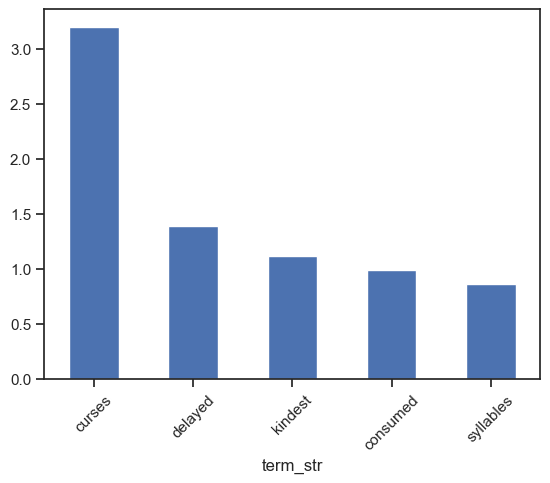

In [259]:
EIG_PAIRS.exp_var.sort_values(ascending=False).head().plot.bar(rot=45);

## Pick Top K (10) Components

We pick these based on explained variance.

In [260]:
COMPS = EIG_PAIRS.sort_values('exp_var', ascending=False).head(10).reset_index(drop=True)
COMPS.index.name = 'comp_id'
COMPS.index = ["PC{}".format(i) for i in COMPS.index.tolist()]
COMPS.index.name = 'pc_id'

In [261]:
COMPS

,eig_val,home,cried,certain,looking,manner,general,felt,set,oh,...,hug,lash,heathen,recesses,syllables,consumed,kindest,delayed,curses,exp_var
pc_id,,,,,,,,,,,,,,,,,,,,,
PC0,0.029835,-0.044456,-0.005779,-0.003176,-0.014338,-0.035223,-0.031659,-0.058332,-0.008730,-0.031270,...,0.002252,0.005791,0.002247,0.002751,-0.000533,0.001108,-0.006958,-0.008662,0.004398,3.20
PC1,0.012971,-0.020406,0.023909,-0.009149,-0.024198,-0.012478,-0.013059,-0.003414,-0.021664,0.067755,...,-0.000538,-0.005778,-0.001521,-0.004318,0.005832,-0.002335,-0.000530,0.000312,0.001134,1.39
PC2,0.010417,0.012649,0.028712,-0.002111,0.001255,0.004902,0.010842,0.020085,0.007611,0.056582,...,-0.000472,-0.002016,-0.003884,-0.007718,-0.000844,0.001017,0.001723,0.002763,0.001064,1.12
PC3,0.009258,-0.027308,-0.043735,0.003548,-0.043091,-0.006738,0.001911,-0.028542,-0.018462,-0.053237,...,-0.001786,-0.008151,-0.001627,-0.001925,-0.002234,0.001237,-0.001453,-0.002257,-0.002148,0.99
PC4,0.007976,0.017941,0.010264,0.002630,0.030248,0.010726,0.013564,0.028077,0.012262,0.017274,...,0.003594,-0.018692,0.006550,0.011341,0.005522,0.008764,0.000599,0.002704,0.003664,0.86
PC5,0.006210,0.000752,-0.120037,-0.005793,-0.045510,0.003571,0.022224,0.015972,-0.007113,-0.085351,...,-0.003868,0.012862,-0.000230,0.003227,-0.003347,0.001887,-0.002259,0.002335,0.002759,0.67
PC6,0.005744,-0.016345,-0.075209,-0.004388,0.038421,-0.006440,-0.012984,-0.000300,-0.003635,-0.002344,...,-0.005176,-0.026450,0.001408,-0.000468,-0.003486,-0.003314,-0.001296,-0.001281,-0.008338,0.62
PC7,0.005285,0.011524,0.053854,-0.041853,-0.022612,-0.012930,-0.051391,0.012417,-0.003956,0.012873,...,0.001520,-0.020855,-0.009681,-0.002809,-0.006819,-0.008589,-0.000558,0.005531,0.002900,0.57
PC8,0.004546,-0.006473,0.016203,0.025064,-0.031046,0.011881,0.003906,0.032316,0.003904,-0.023072,...,0.006472,0.006951,-0.000636,0.001898,0.002703,0.003828,-0.001963,0.002111,0.009944,0.49


## See Projected Components onto Vocabulary (Loadings)

Loadings sow the contribution of each term to the component. \
We'll just look at the topi 10 words for the first two components in the Book version.

In [262]:
LOADINGS = COMPS[COV.index].T
LOADINGS.index.name = 'term_str'

In [263]:
LOADINGS.head(10).style.background_gradient(cmap=colors)

pc_id,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
term_str,,,,,,,,,,
home,-0.044456,-0.020406,0.012649,-0.027308,0.017941,0.000752,-0.016345,0.011524,-0.006473,-0.000826
cried,-0.005779,0.023909,0.028712,-0.043735,0.010264,-0.120037,-0.075209,0.053854,0.016203,0.048008
certain,-0.003176,-0.009149,-0.002111,0.003548,0.002630,-0.005793,-0.004388,-0.041853,0.025064,-0.007324
looking,-0.014338,-0.024198,0.001255,-0.043091,0.030248,-0.045510,0.038421,-0.022612,-0.031046,-0.015286
manner,-0.035223,-0.012478,0.004902,-0.006738,0.010726,0.003571,-0.006440,-0.012930,0.011881,0.005372
general,-0.031659,-0.013059,0.010842,0.001911,0.013564,0.022224,-0.012984,-0.051391,0.003906,-0.029317
felt,-0.058332,-0.003414,0.020085,-0.028542,0.028077,0.015972,-0.000300,0.012417,0.032316,-0.055106
set,-0.008730,-0.021664,0.007611,-0.018462,0.012262,-0.007113,-0.003635,-0.003956,0.003904,0.011567
oh,-0.031270,0.067755,0.056582,-0.053237,0.017274,-0.085351,-0.002344,0.012873,-0.023072,0.026634


In [264]:
top_terms = []
for i in range(10):
    for j in [0, 1]:
        comp_str = ' '.join(LOADINGS.sort_values(f'PC{i}', ascending=bool(j)).head(10).index.to_list())
        top_terms.append((f"PC{i}", j, comp_str))
COMP_GLOSS = pd.DataFrame(top_terms).set_index([0,1]).unstack()
COMP_GLOSS.index.name = 'comp_id'
COMP_GLOSS.columns = COMP_GLOSS.columns.droplevel(0) 
COMP_GLOSS = COMP_GLOSS.rename(columns={0:'pos', 1:'neg'})

In [265]:
COMP_GLOSS

1,pos,neg
comp_id,,
PC0,whale thou sea ye ship deck thee boat thy whales,am sister dear think letter had mother do wish...
PC1,thou thee thy hath art oh hast brother thine ye,whale ship deck sailors boat mate sea ships wa...
PC2,whale whales thou thee boat ye boats ship thy ...,natives valley cosmopolitan doctor island isla...
PC3,whale whales cosmopolitan fish oil tail acquai...,thou thee deck thy ship sailors mate ye jacket...
PC4,valley natives island islanders fruit trees ca...,cosmopolitan deck war jacket officers sailors ...
PC5,thee thou mother thy officers natives daughter...,lord said dont ye cosmopolitan wine cried ha y...
PC6,cosmopolitan doctor dont natives confidence co...,lord war beard officers kings isle frigate dem...
PC7,boat ye sail canoe sea reef breeze sails prow ...,war whale american book cosmopolitan officers ...
PC8,cosmopolitan boat nature confidence philosophy...,doctor room ladies town street whale dance gui...


In [266]:
# COMPS.join(COMP_GLOSS)

## Project Docs onto Components

We get the dot product of the DTM matrix and the new component matrix, which we will call DCM -- for document-component matrix. \
This has the effect of replacing the features of the DTM with the features of the transposed component matrix.

In [267]:
# We use the index to get only PC features, so matrices align
# DCM = TFIDF_L2.dot(COMPS[COV.index].T) 

In [268]:
# We use the index to get only PC features, so matrices align
DCM = TFIDF_L2.dot(LOADINGS) 

In [269]:
DCM

pc_id                 PC0       PC1       PC2       PC3       PC4       PC5  \
book_id chap_id                                                               
105     1       -0.331213 -0.059680  0.069805 -0.053606  0.103261  0.053315   
        2       -0.316358 -0.068685  0.075064 -0.065186  0.111107  0.036390   
        3       -0.306819 -0.108418  0.104807 -0.167948  0.091955 -0.080351   
        4       -0.320340 -0.057092  0.077401 -0.061582  0.101927  0.063695   
        5       -0.422699 -0.104049  0.124092 -0.163381  0.165701 -0.078602   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.058506  0.156549  0.160039 -0.218476  0.150829  0.015335   
        111     -0.018699  0.170889  0.144013 -0.198877  0.098356 -0.036394   
        112      0.003369  0.003627  0.053594 -0.131294  0.115281 -0.070466   
        113      0.034247  0.257117  0.146149 -0.192179  0.082432 -0.008222   
        114      0.041839  0.161857  0.144454 -0.263554  0.110009 -0.043161   

pc_id                 PC6       PC7       PC8       PC9  
book_id chap_id                                          
105     1       -0.116194 -0.111393  0.042480 -0.097653  
        2       -0.066064 -0.089956  0.110692 -0.011938  
        3       -0.107554 -0.149014  0.036127  0.026335  
        4       -0.096441 -0.083886  0.166568 -0.041072  
        5       -0.045304 -0.085942 -0.010227 -0.025318  
...                   ...       ...       ...       ...  
34970   110      0.013376  0.007421  0.098288 -0.018583  
        111      0.017925 -0.113679  0.022290 -0.087516  
        112     -0.009626 -0.042977 -0.002867 -0.090833  
        113     -0.031986 -0.074775  0.000893 -0.050295  
        114      0.010479 -0.066622  0.028224 -0.030855  

[1183 rows x 10 columns]

We add metadata to our new, reduced matrices for display purposes.

In [270]:
DCM = DCM.join(LIB[LIB_COLS], on='book_id')

We define a `doc` field to name each chapter.

In [271]:
DCM['doc'] = DCM.apply(lambda x: f"{x.label} {str(x.name[1]).zfill(2)}", 1)

In [272]:
DCM.doc

book_id  chap_id
105      1                         Austen: Persuasion (105) 01
         2                         Austen: Persuasion (105) 02
         3                         Austen: Persuasion (105) 03
         4                         Austen: Persuasion (105) 04
         5                         Austen: Persuasion (105) 05
                                       ...                    
34970    110        Melville: Pierre Or The Ambigu (34970) 110
         111        Melville: Pierre Or The Ambigu (34970) 111
         112        Melville: Pierre Or The Ambigu (34970) 112
         113        Melville: Pierre Or The Ambigu (34970) 113
         114        Melville: Pierre Or The Ambigu (34970) 114
Name: doc, Length: 1183, dtype: object

In [273]:
DCM

PC0       PC1       PC2       PC3       PC4       PC5  \
book_id chap_id                                                               
105     1       -0.331213 -0.059680  0.069805 -0.053606  0.103261  0.053315   
        2       -0.316358 -0.068685  0.075064 -0.065186  0.111107  0.036390   
        3       -0.306819 -0.108418  0.104807 -0.167948  0.091955 -0.080351   
        4       -0.320340 -0.057092  0.077401 -0.061582  0.101927  0.063695   
        5       -0.422699 -0.104049  0.124092 -0.163381  0.165701 -0.078602   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.058506  0.156549  0.160039 -0.218476  0.150829  0.015335   
        111     -0.018699  0.170889  0.144013 -0.198877  0.098356 -0.036394   
        112      0.003369  0.003627  0.053594 -0.131294  0.115281 -0.070466   
        113      0.034247  0.257117  0.146149 -0.192179  0.082432 -0.008222   
        114      0.041839  0.161857  0.144454 -0.263554  0.110009 -0.043161   

                      PC6       PC7       PC8       PC9            author  \
book_id chap_id                                                             
105     1       -0.116194 -0.111393  0.042480 -0.097653      AUSTEN, JANE   
        2       -0.066064 -0.089956  0.110692 -0.011938      AUSTEN, JANE   
        3       -0.107554 -0.149014  0.036127  0.026335      AUSTEN, JANE   
        4       -0.096441 -0.083886  0.166568 -0.041072      AUSTEN, JANE   
        5       -0.045304 -0.085942 -0.010227 -0.025318      AUSTEN, JANE   
...                   ...       ...       ...       ...               ...   
34970   110      0.013376  0.007421  0.098288 -0.018583  MELVILLE, HERMAN   
        111      0.017925 -0.113679  0.022290 -0.087516  MELVILLE, HERMAN   
        112     -0.009626 -0.042977 -0.002867 -0.090833  MELVILLE, HERMAN   
        113     -0.031986 -0.074775  0.000893 -0.050295  MELVILLE, HERMAN   
        114      0.010479 -0.066622  0.028224 -0.030855  MELVILLE, HERMAN   

                                     title  \
book_id chap_id                              
105     1                       PERSUASION   
        2                       PERSUASION   
        3                       PERSUASION   
        4                       PERSUASION   
        5                       PERSUASION   
...                                    ...   
34970   110      PIERRE OR THE AMBIGUITIES   
        111      PIERRE OR THE AMBIGUITIES   
        112      PIERRE OR THE AMBIGUITIES   
        113      PIERRE OR THE AMBIGUITIES   
        114      PIERRE OR THE AMBIGUITIES   

                                                  label     genre  \
book_id chap_id                                                     
105     1                      Austen: Persuasion (105)  domestic   
        2                      Austen: Persuasion (105)  domestic   
        3                      Austen: Persuasion (105)  domestic   
        4                      Austen: Persuasion (105)  domestic   
        5                      Austen: Persuasion (105)  domestic   
...                                                 ...       ...   
34970   110      Melville: Pierre Or The Ambigu (34970)    gothic   
        111      Melville: Pierre Or The Ambigu (34970)    gothic   
        112      Melville: Pierre Or The Ambigu (34970)    gothic   
        113      Melville: Pierre Or The Ambigu (34970)    gothic   
        114      Melville: Pierre Or The Ambigu (34970)    gothic   

                          mode                                         doc  
book_id chap_id                                                             
105     1              romance                 Austen: Persuasion (105) 01  
        2              romance                 Austen: Persuasion (105) 02  
        3              romance                 Austen: Persuasion (105) 03  
        4              romance                 Austen: Persuasion (105) 04  
        5              romance   

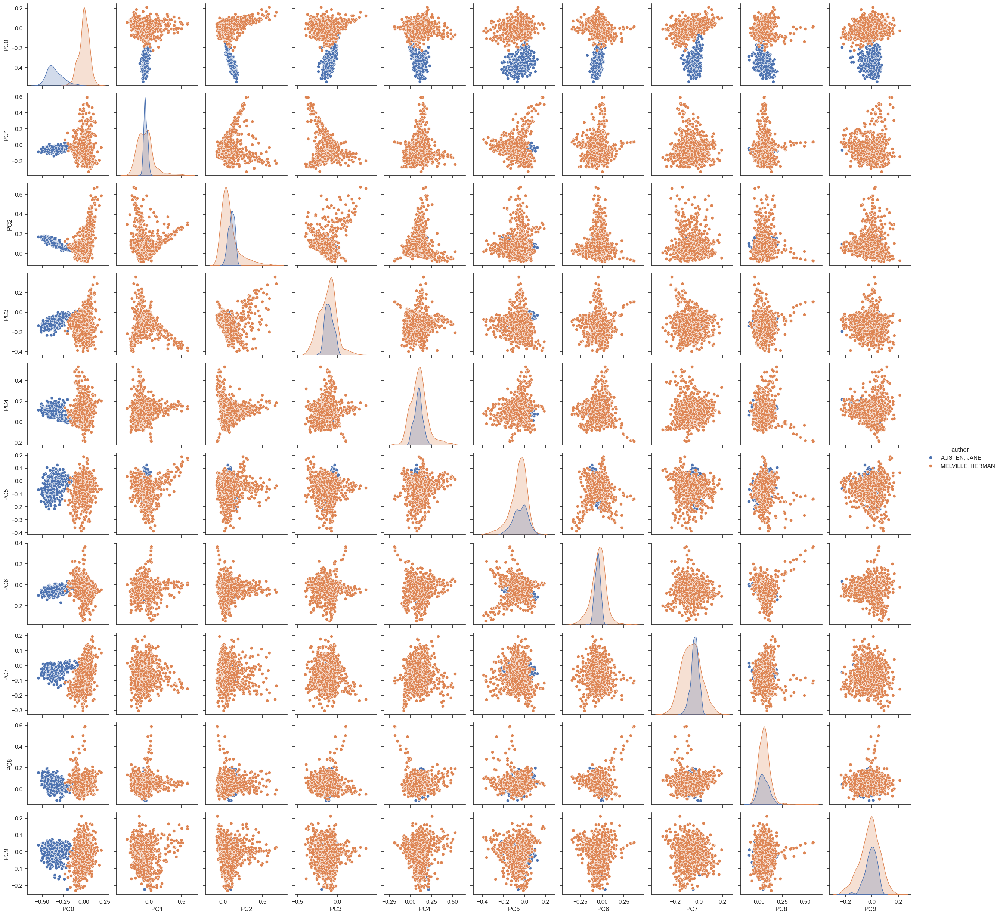

In [274]:
sns.pairplot(DCM.iloc[:, :], hue='author')

# Visualize

In [275]:
def vis_pcs(M, a, b, label='author', hover_name='doc', symbol=None, size=None):
    return px.scatter(M, f"PC{a}", f"PC{b}", color=label, hover_name=hover_name, 
                     symbol=symbol, size=size,
                     marginal_x='box', height=800)

In [276]:
def vis_loadings(a=0, b=1, hover_name='term_str'):
    # X = LOADINGS.join(VOCAB)
    X = LOADINGS.join(VSHORT)
    return px.scatter(X.reset_index(), f"PC{a}", f"PC{b}", 
                      text='term_str', size='i', color='max_pos_group', 
                      marginal_x='box', height=800)

## PC 0 and 1

### Author

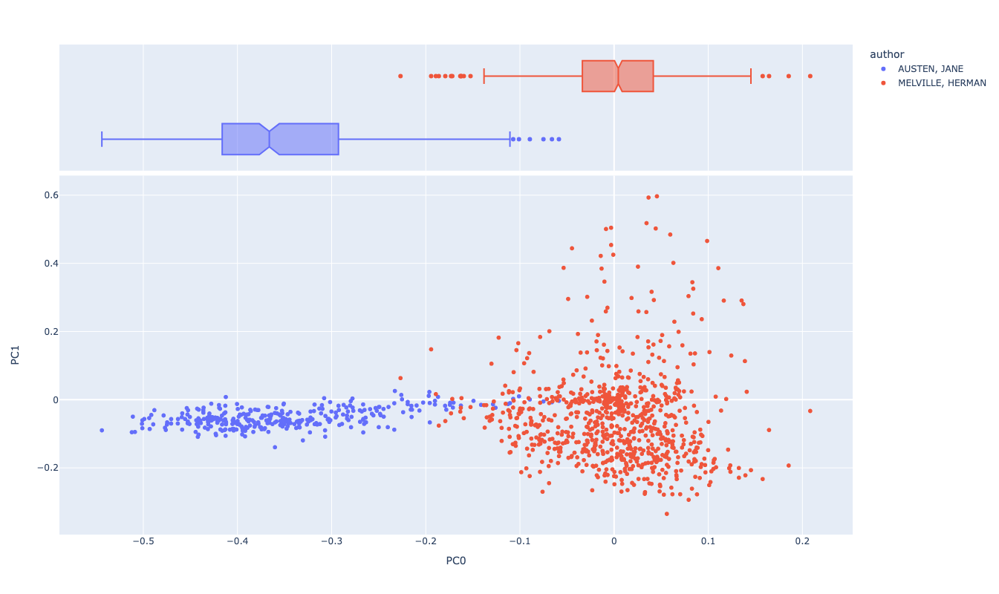

In [277]:
vis_pcs(DCM, 0, 1)

### Loadings

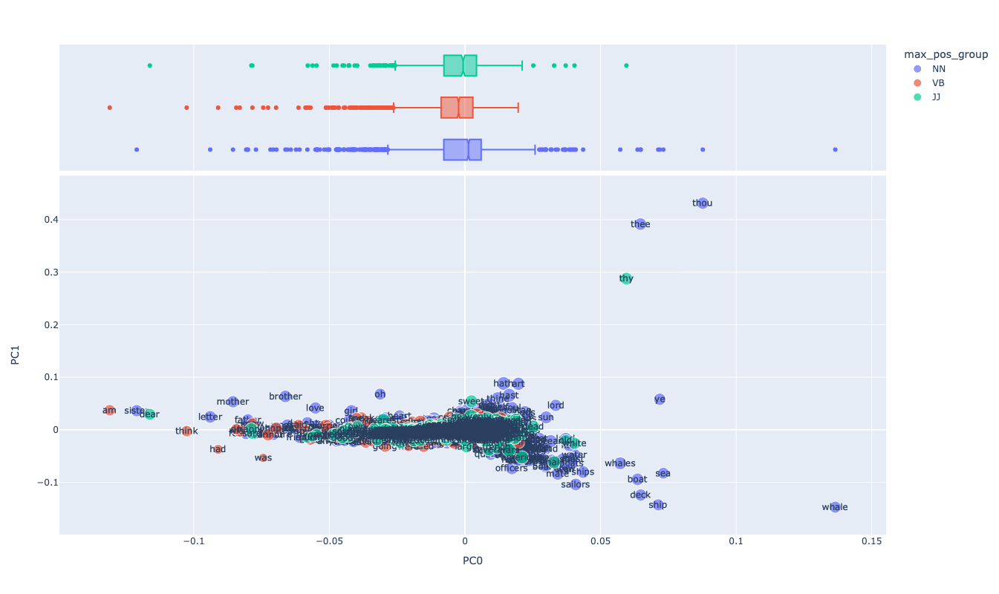

In [278]:
vis_loadings(0,1)

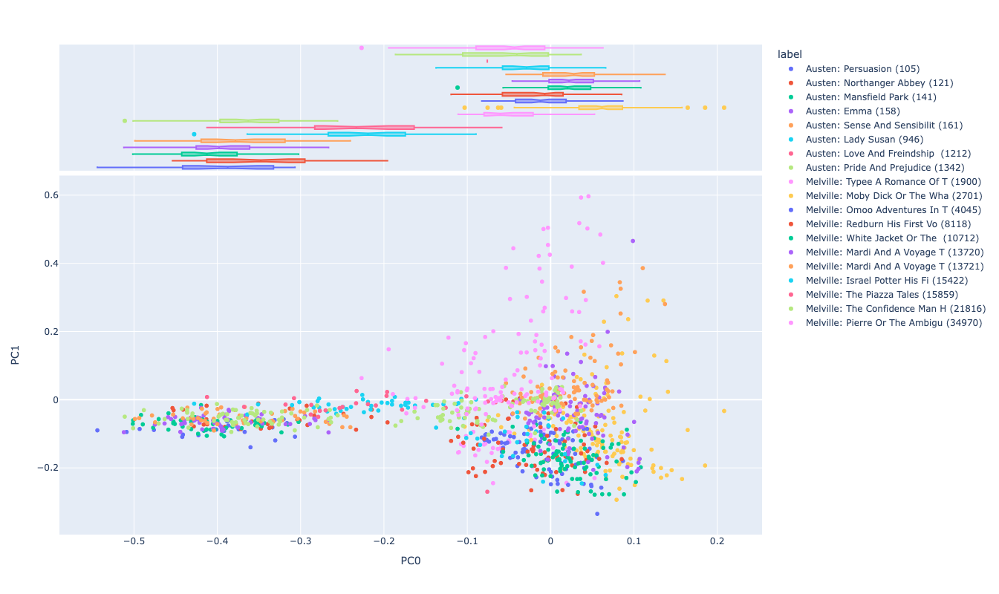

In [279]:
vis_pcs(DCM, 0, 1, label='label')

### Genre

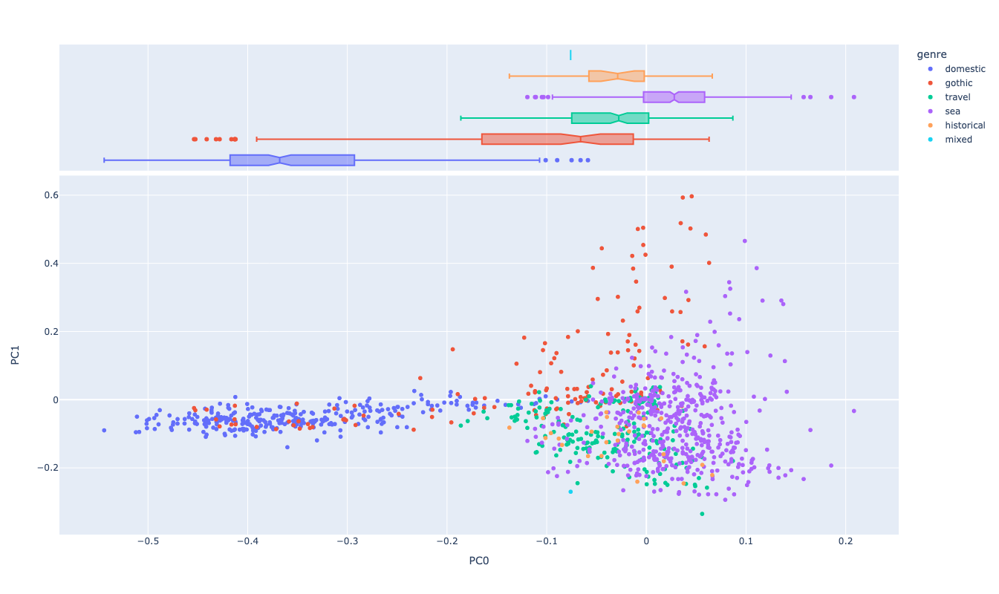

In [280]:
vis_pcs(DCM, 0, 1, label='genre')

### Mode

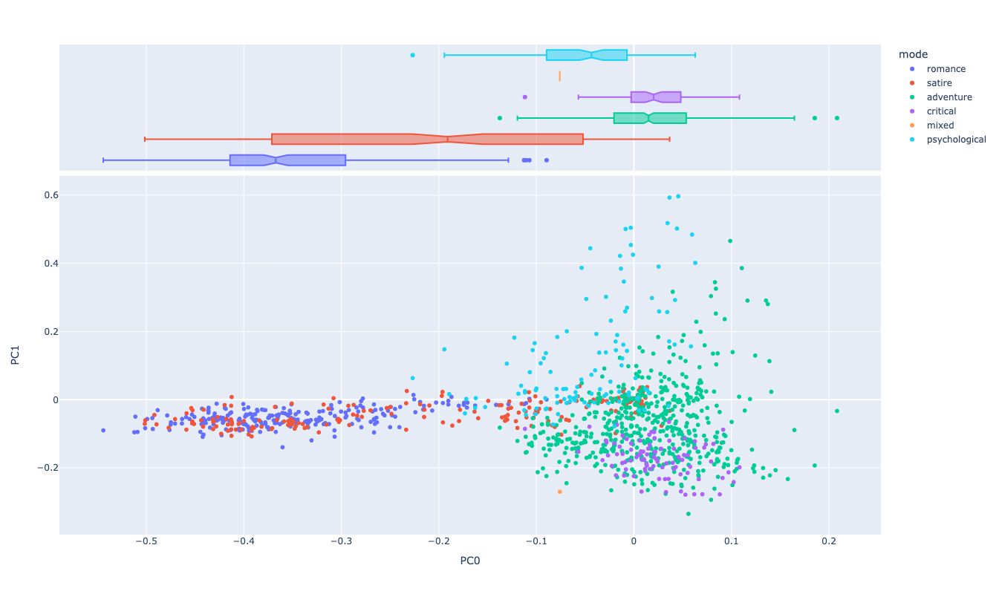

In [281]:
vis_pcs(DCM, 0, 1, label='mode')

### Title

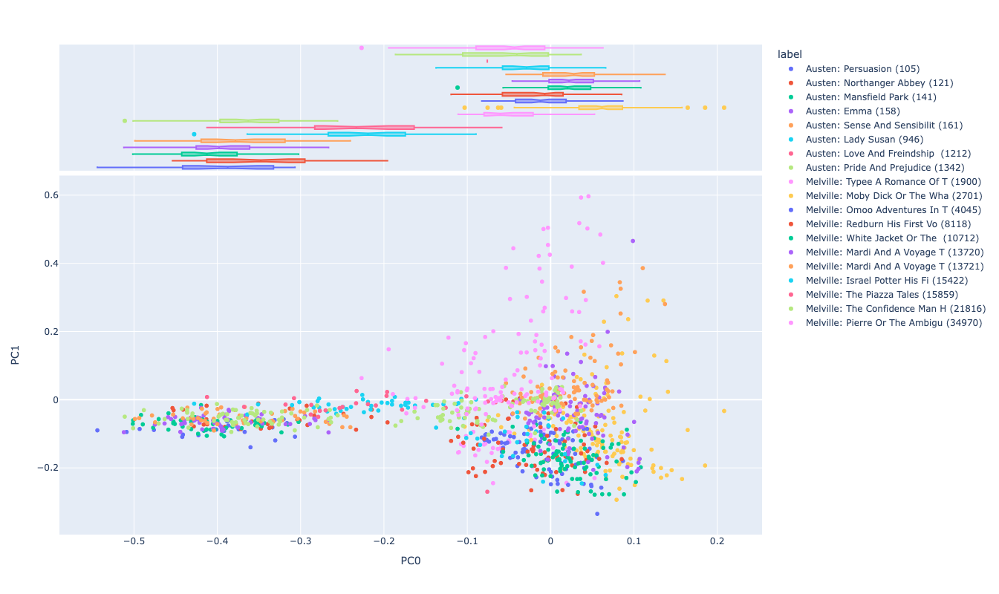

In [282]:
vis_pcs(DCM, 0, 1, label='label')

## PC 1 and 2

### Author

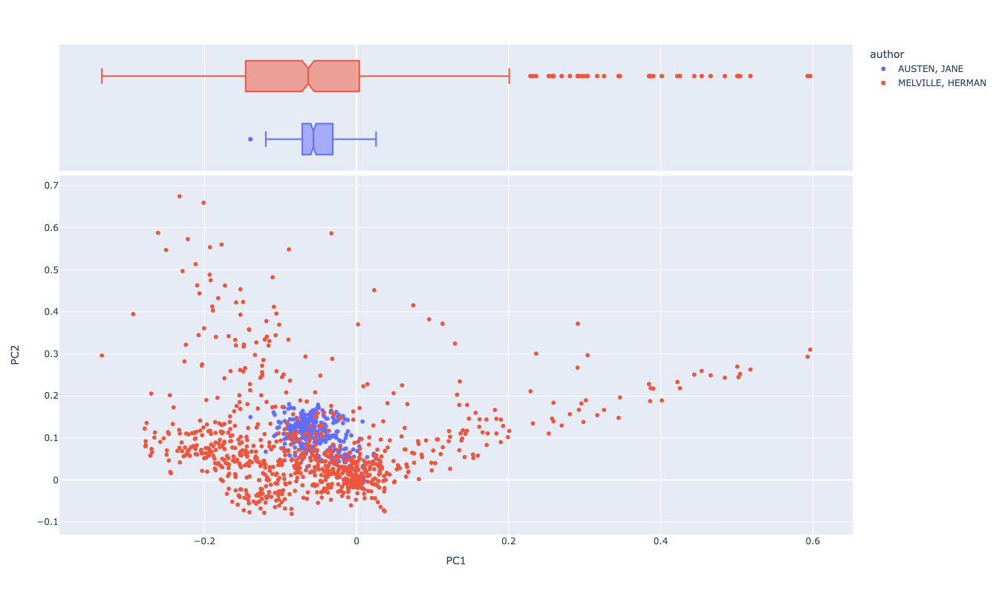

In [283]:
vis_pcs(DCM, 1, 2)

### Loadings

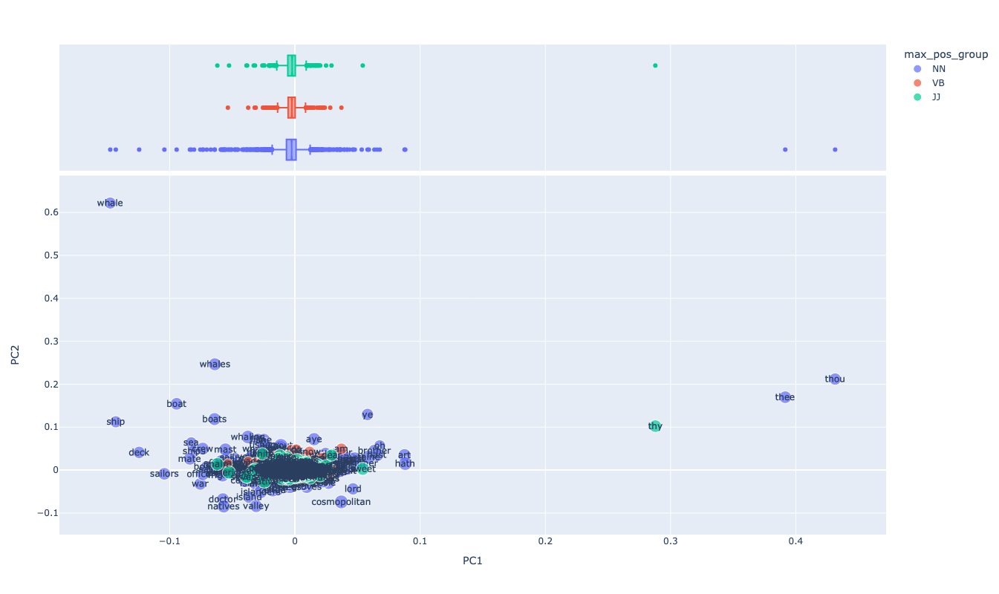

In [284]:
vis_loadings(1, 2)

### Genre

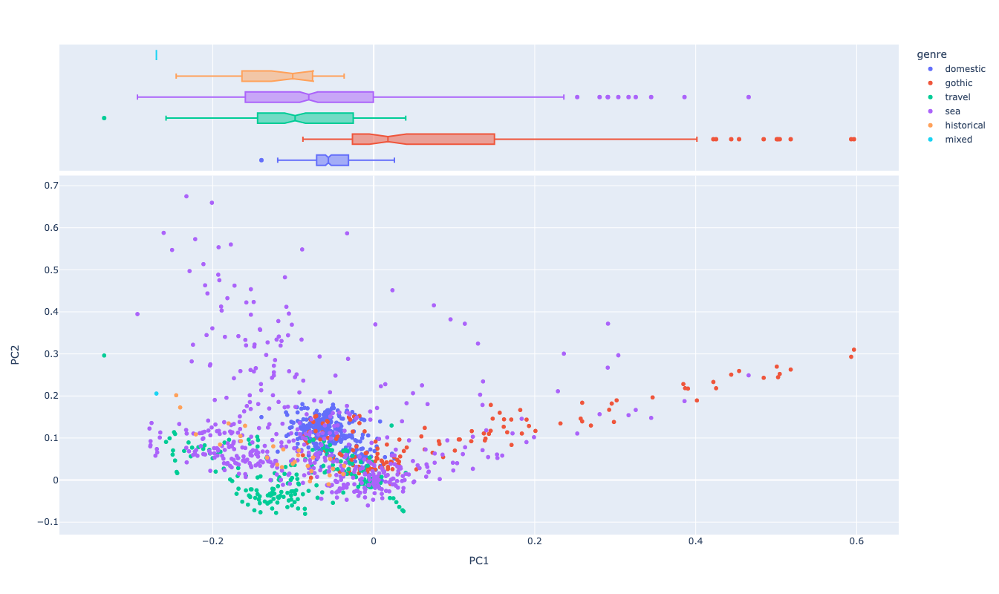

In [285]:
vis_pcs(DCM, 1, 2, label='genre')

### Mode

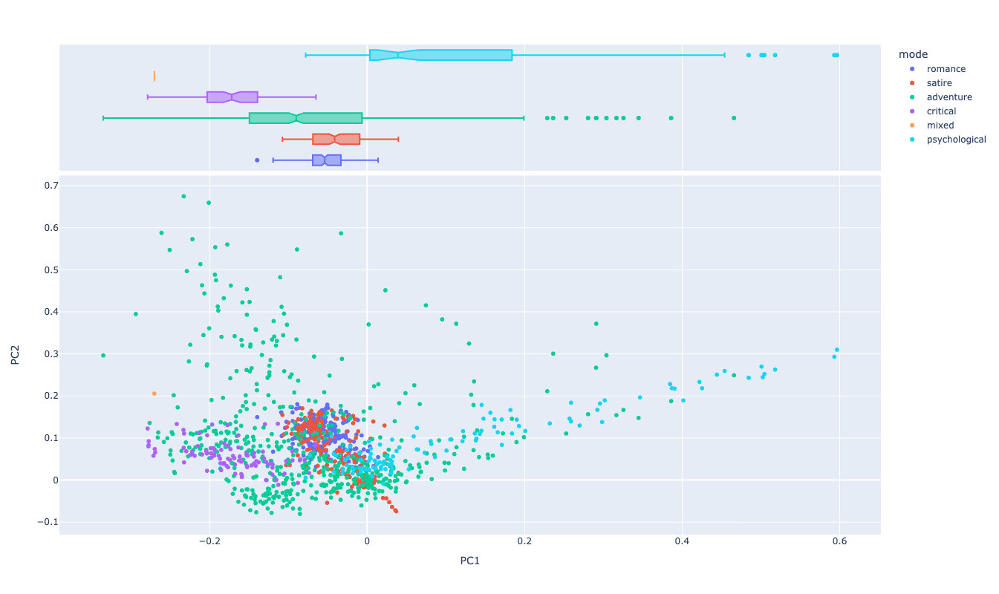

In [286]:
vis_pcs(DCM, 1, 2, label='mode')

### Title

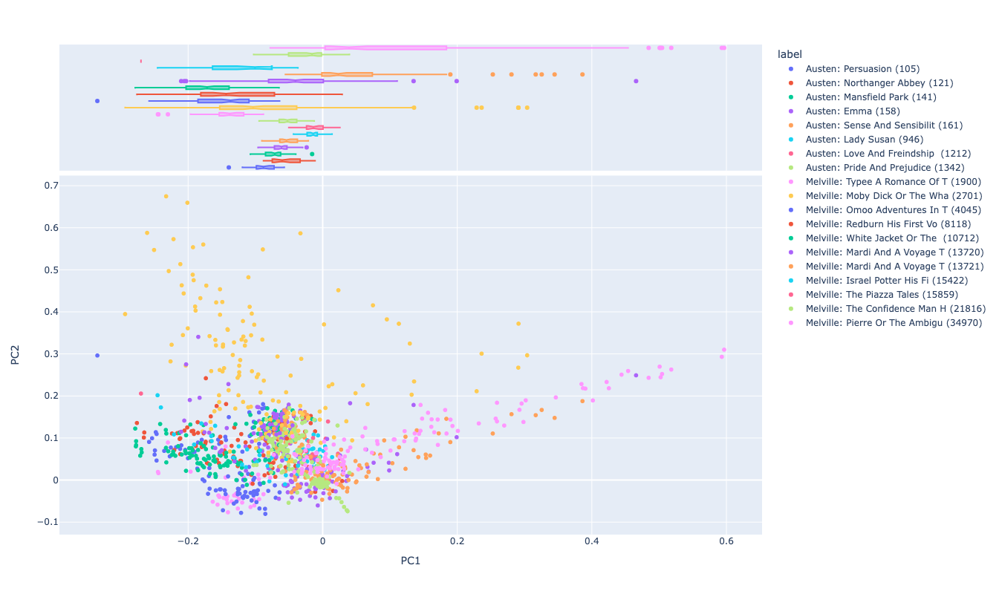

In [287]:
vis_pcs(DCM, 1, 2, label='label')

## PC 2 and 3

### Author

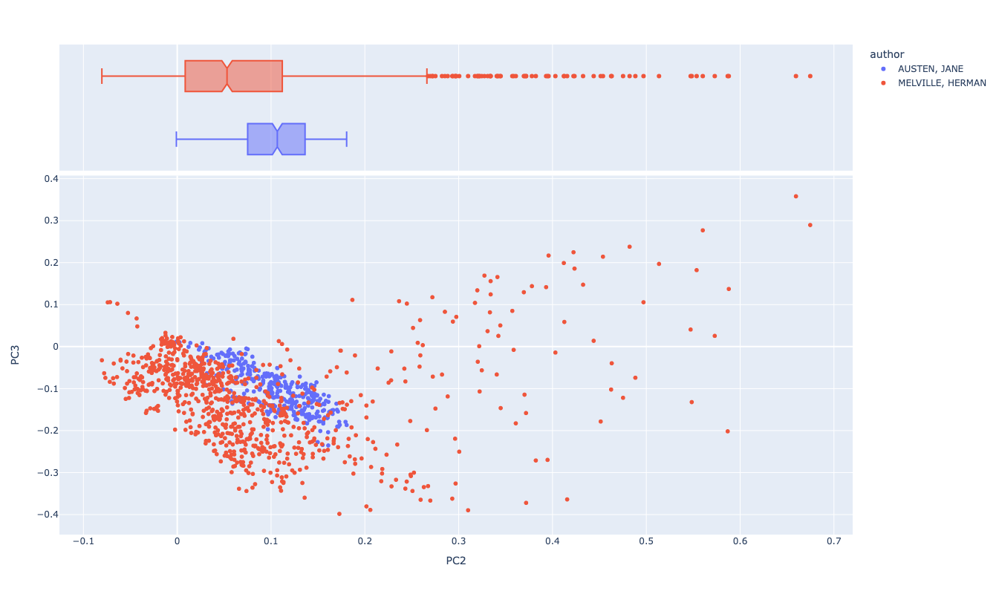

In [288]:
vis_pcs(DCM, 2, 3)

### Loadings

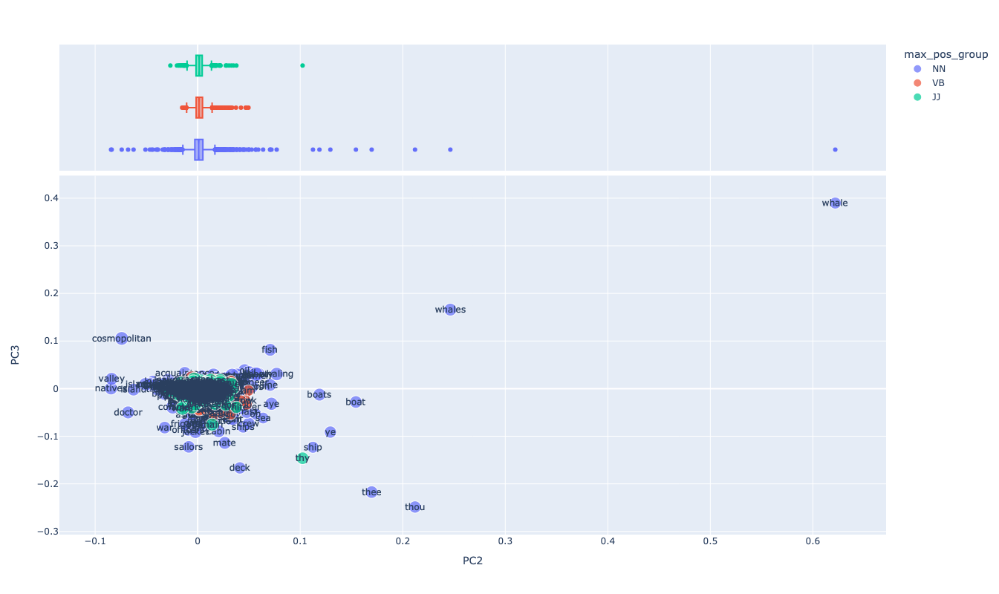

In [289]:
vis_loadings(2, 3)

### Genre

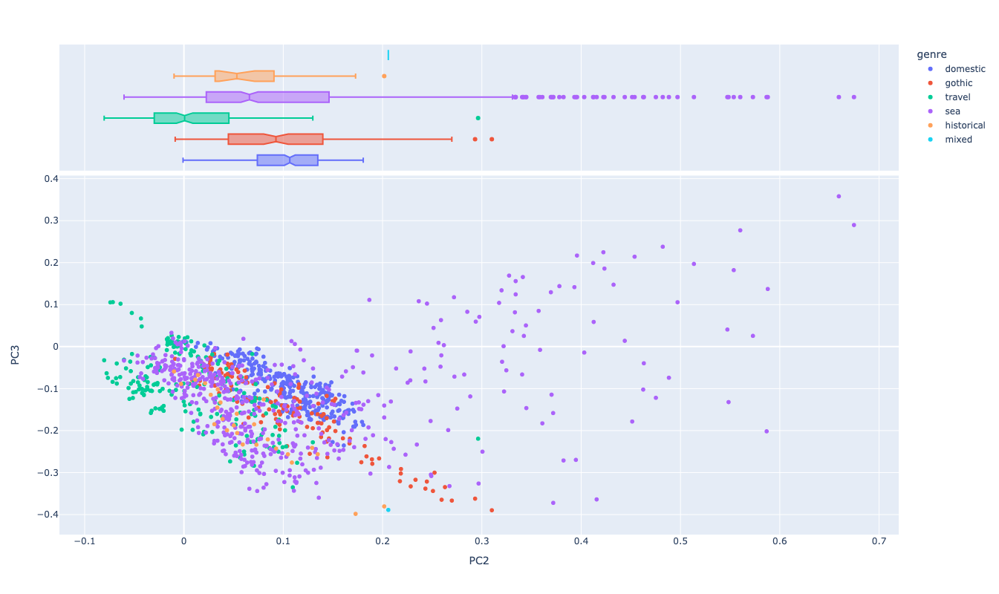

In [290]:
vis_pcs(DCM, 2, 3, label='genre')

### Mode

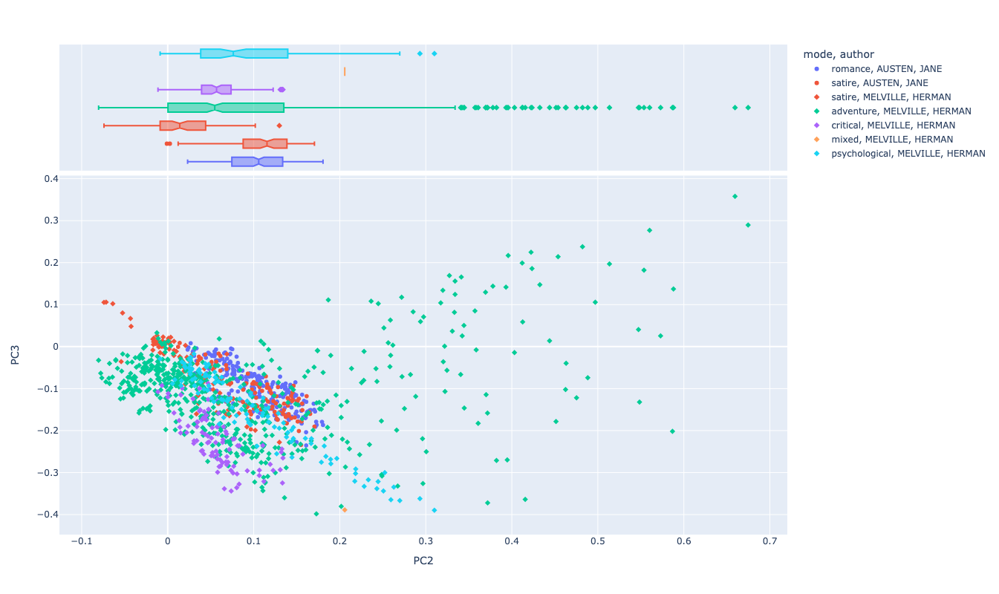

In [291]:
vis_pcs(DCM, 2, 3, label='mode', symbol='author')

### Title

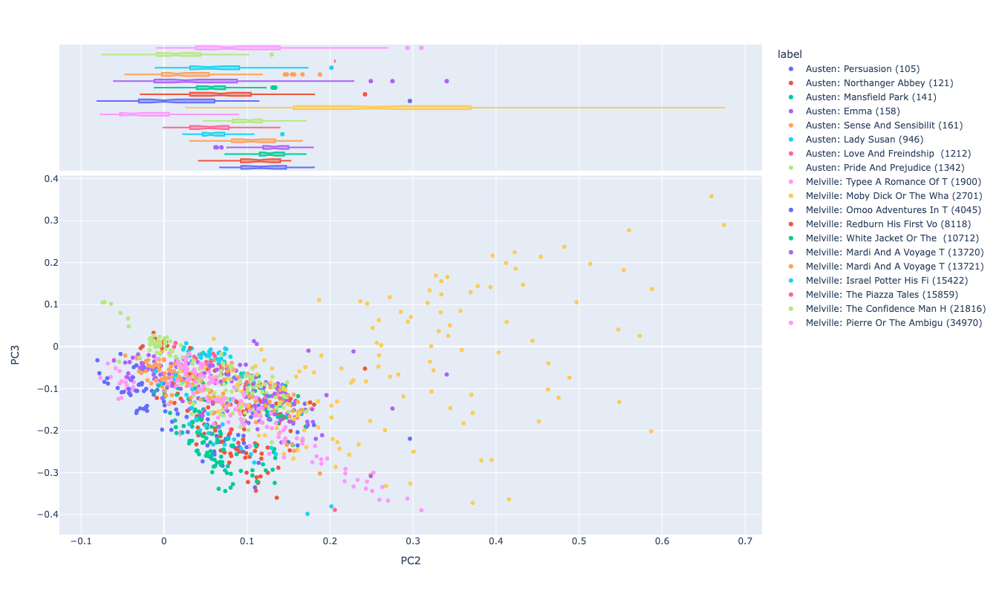

In [292]:
vis_pcs(DCM, 2, 3, label='label')

## PC 3 and 4

### Author

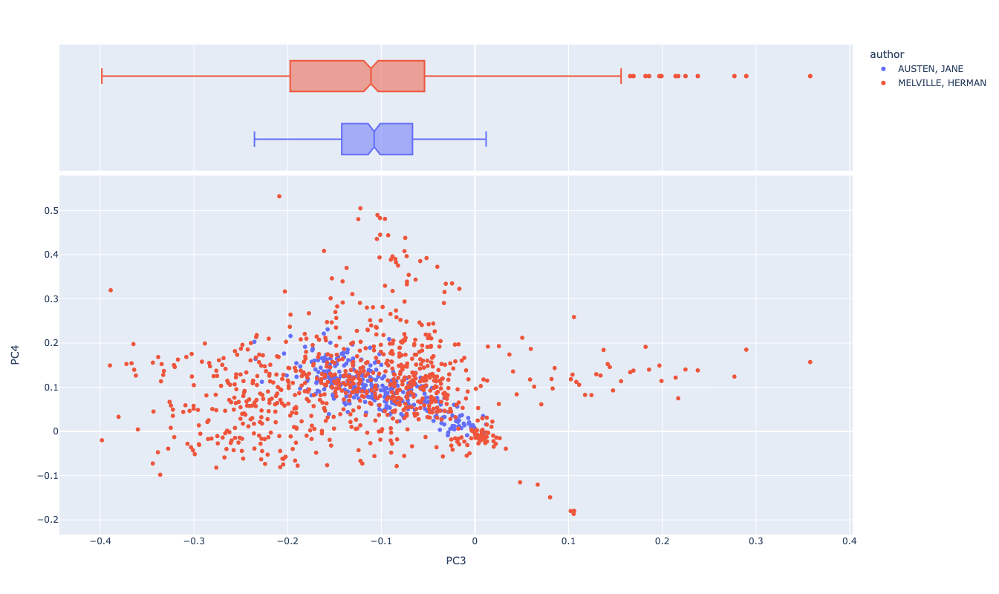

In [293]:
vis_pcs(DCM, 3, 4, label='author')

### Loadings

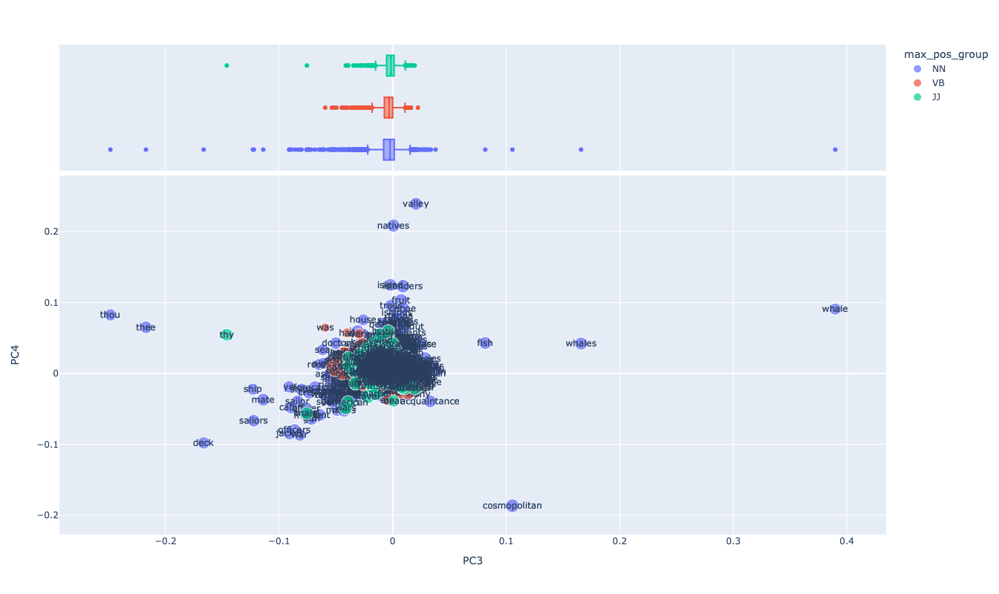

In [294]:
vis_loadings(3, 4)

### Genre

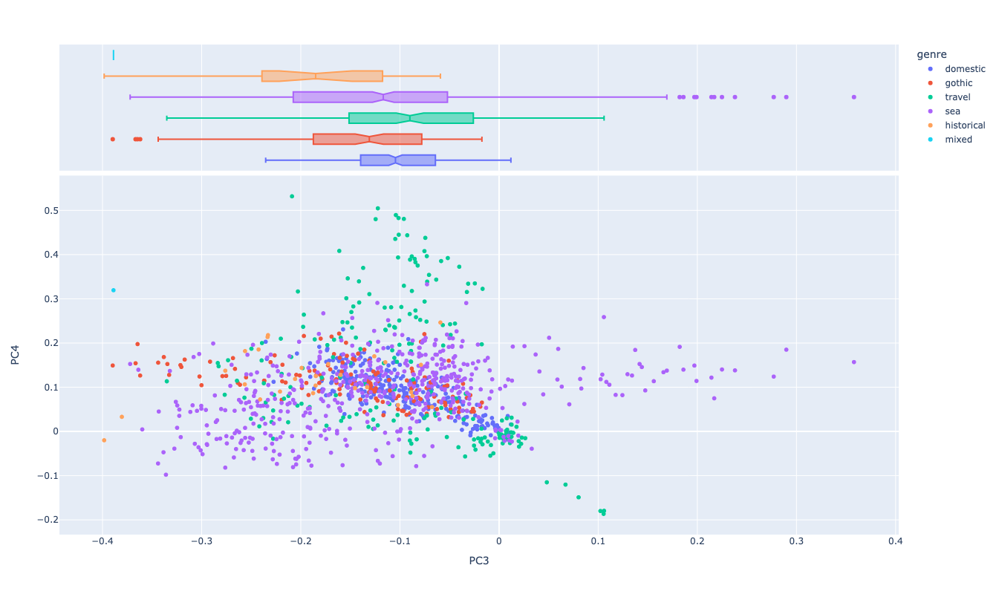

In [295]:
vis_pcs(DCM, 3, 4, label='genre')

### Mode

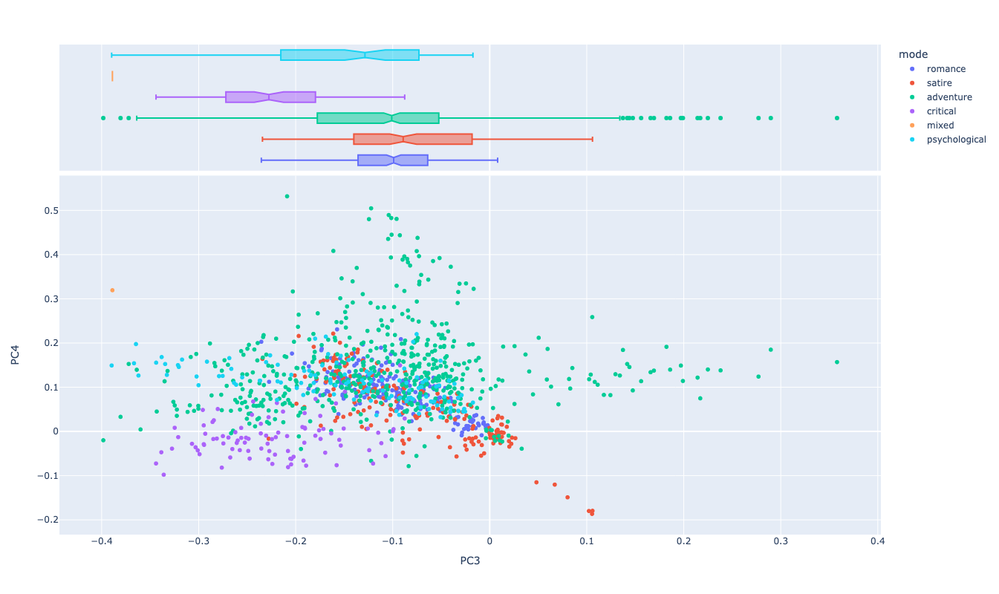

In [296]:
vis_pcs(DCM, 3, 4, label='mode')

### Title

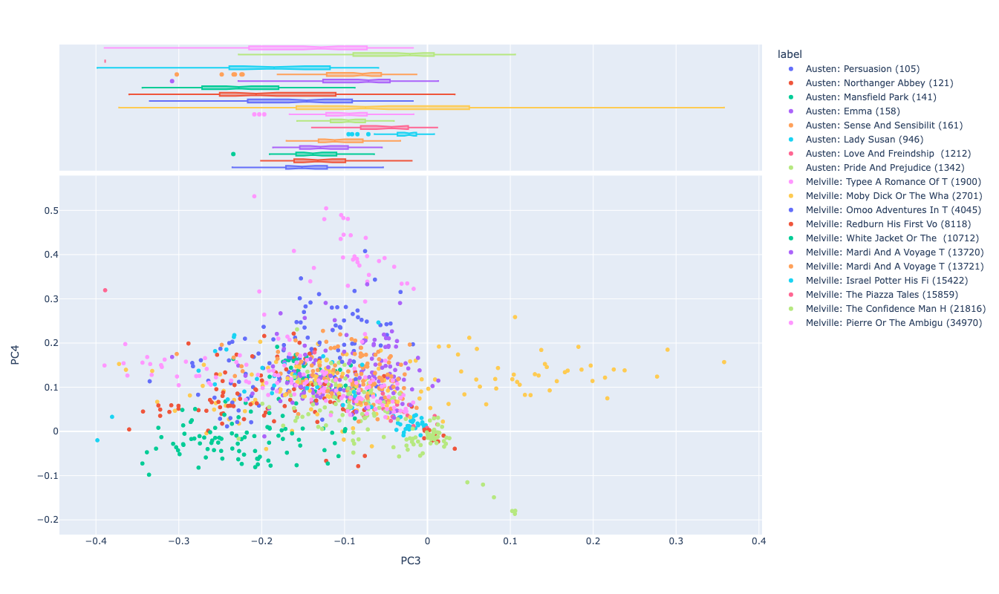

In [297]:
vis_pcs(DCM, 3, 4, label='label')

## Dendrograms

In [298]:
import sys
sys.path.append(local_lib)
from hac2 import HAC

We group DCM by book and get mean PC values.

In [318]:
X = DCM[COMPS.index].groupby('book_id').mean()
titles = LIB.loc[list(X.index)].apply(lambda x: x.label + ' ' + x.genre.upper(), 1)
X.index = titles

<Axes: >

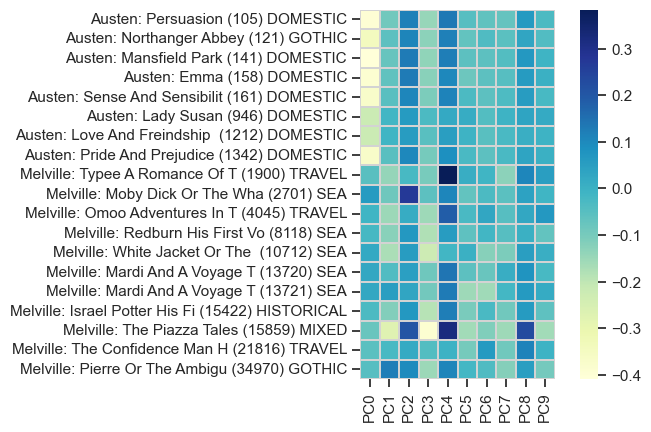

In [319]:
sns.heatmap(X, cmap='YlGnBu', square=True, linewidths=.01, linecolor='lightgray')

<Figure size 640x480 with 0 Axes>

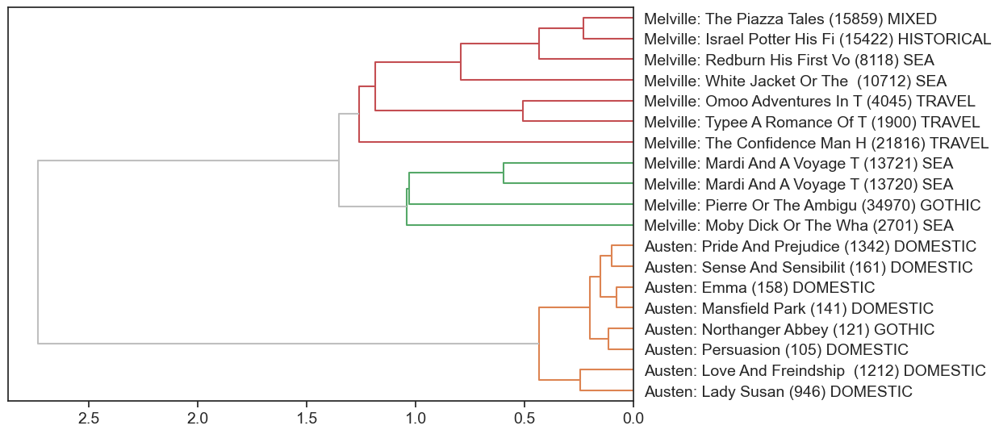

In [301]:
fig1 = HAC(X)
fig1.dist_metric = 'euclidean'
fig1.linkage_method = 'ward'
fig1.color_thresh = 1.3
fig1.plot();

Compare this to clustering on the raw TFIDF data.

In [348]:
X2 = TFIDF_L2.groupby('book_id').mean().join(LIB.label).reset_index(drop=True).set_index('label')

<Figure size 640x480 with 0 Axes>

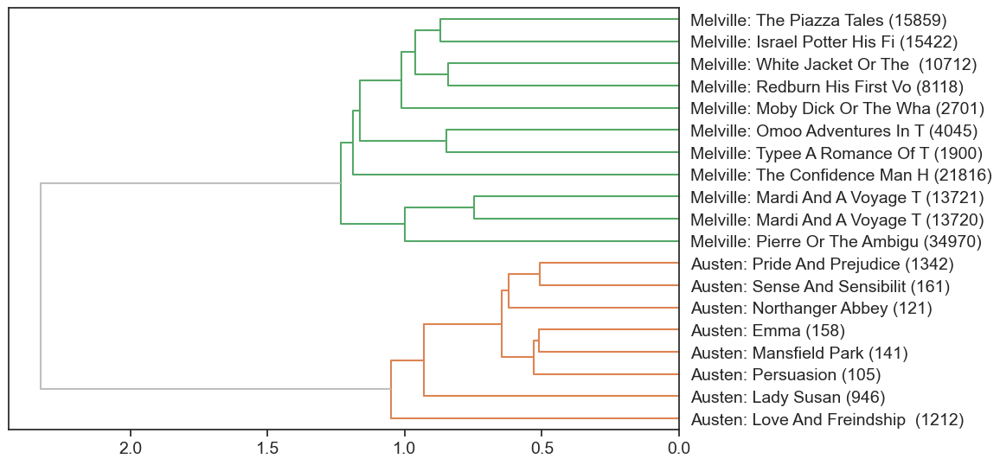

In [349]:
fig2 = HAC(X2)
fig2.dist_metric = 'euclidean'
fig2.linkage_method = 'ward'
fig2.color_thresh = 1.3
fig2.plot();

# Convert Clusters to Topics

Let's see if we can covert our clusters into topics.

In [330]:
from sklearn.cluster import AgglomerativeClustering

In [331]:
LIB = LIB.dropna().copy()

In [332]:
n_clusters = 7
cluster = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
LIB['cluster'] = cluster.fit_predict(X)  + 1

In [334]:
LIB['cluster2'] = cluster.fit_predict(X2)  + 1

In [336]:
LIB[['label','cluster','cluster2']].sort_values('cluster').style.background_gradient(cmap='Paired')

,label,cluster,cluster2
book_id,,,
13720,Melville: Mardi And A Voyage T (13720),1,1
13721,Melville: Mardi And A Voyage T (13721),1,1
34970,Melville: Pierre Or The Ambigu (34970),1,1
21816,Melville: The Confidence Man H (21816),1,1
15422,Melville: Israel Potter His Fi (15422),2,3
10712,Melville: White Jacket Or The (10712),2,3
4045,Melville: Omoo Adventures In T (4045),2,3
8118,Melville: Redburn His First Vo (8118),2,3
1212,Austen: Love And Freindship (1212),3,6


In [342]:
TOPIC = TFIDF_L2\
    .join(LIB.cluster, rsuffix='_Y')\
    .groupby('cluster_Y').mean().T\
    .apply(lambda x: ', '.join(x.sort_values(ascending=False).head(10).index)).T\
    .to_frame('topic_gloss')

In [343]:
TOPIC[['topic_gloss']].style.background_gradient()

,topic_gloss
cluster_Y,
1,"thou, thee, thy, lord, cosmopolitan, old, said, cried, soul, ye"
2,"deck, sailors, ship, doctor, war, sea, mate, jacket, sailor, board"
3,"am, dear, tho, mother, letter, daughter, has, cannot, yours, street"
4,"valley, natives, islanders, savages, cocoanut, fruit, taboo, tappa, mats, inhabitants"
5,"am, had, sister, was, think, dear, do, room, said, know"
6,"negro, isle, spanish, ship, servant, isles, master, boat, prefer, office"
7,"whale, whales, ye, ship, thou, boat, sea, whaling, boats, aye"


In [313]:
# XV = LOADINGS.loc[VSHORT.sort_values('dfidf', ascending=False).head(100).index]

In [314]:
# HAC(XV).plot()

In [315]:
# XV2 = LOADINGS.loc[VSHORT.sample(50).index]

In [316]:
# HAC(XV2).plot()

# SAVE

In [317]:
# TFIDF.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap.csv")
TFIDF_L2.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap_L2.csv")
DCM.iloc[:,:10].to_csv(f"{output_dir}/{data_prefix}-PCA_DCM_chap.csv")
COMPS.iloc[:,[0,-1]].to_csv(f"{output_dir}/{data_prefix}-PCA_COMPS_chap.csv")
LOADINGS.to_csv(f"{output_dir}/{data_prefix}-PCA_TCM_chap.csv")
TOPIC.to_csv(f"{output_dir}/{data_prefix}-CLUSTER_TOPIC_book.csv")